# Scattering Transform for 1-D signals 
## Parkinson Speech Dataset with Multiple Types of Sound Recordings Data Set
Source : https://archive.ics.uci.edu/ml/datasets/Parkinson+Speech+Dataset+with++Multiple+Types+of+Sound+Recordings#
Paper : Erdogdu Sakar, B., Isenkul, M., Sakar, C.O., Sertbas, A., Gurgen, F., Delil, S., Apaydin, H., Kursun, O., 'Collection and Analysis of a Parkinson Speech Dataset with Multiple Types of Sound Recordings', IEEE Journal of Biomedical and Health Informatics, vol. 17(4), pp. 828-834, 2013.


In [2]:
from scipy.io import wavfile
import matplotlib.pyplot as plt
from scattering import *
import glob
import librosa
import librosa.display


%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt

import seaborn as sb
sb.set(style="white", palette="muted")

import pandas as pd

# Original note book from ESC-Dataset 
- [Link](https://github.com/karoldvl/paper-2015-esc-dataset/blob/master/Notebook/ESC-Dataset-for-Environmental-Sound-Classification.ipynb)

In [3]:
import numpy as np
import pydub
import librosa
#
class Clip:
    """A single 5-sec long recording."""
    
    RATE = 44100   # All recordings in the PD dataset are sampled at 44.1 kHz
    FRAME = 512    # Frame size in samples (can change this based on classification result)
    
    class Audio:
        """The actual audio data of the clip.
        
            Uses a context manager to load/unload the raw audio data. This way clips
            can be processed sequentially with reasonable memory usage.
        """
        
        def __init__(self, path):
            self.path = path
        
        def __enter__(self):
            # Actual recordings are sometimes not frame accurate, so we trim/overlay to exactly 5 seconds
            self.data = pydub.AudioSegment.silent(duration=10000)
            self.data = self.data.overlay(pydub.AudioSegment.from_file(self.path)[0:10000])
            self.raw = (np.fromstring(self.data._data, dtype="int16") + 0.5) / (0x7FFF + 0.5)   # convert to float
            return(self)
        
        def __exit__(self, exception_type, exception_value, traceback):
            if exception_type is not None:
                print(exception_type, exception_value, traceback)
            del self.data
            del self.raw
        
    def __init__(self, filename):
        self.filename = os.path.basename(filename)
        self.path = os.path.abspath(filename)        
        self.directory = os.path.dirname(self.path)
        self.category = self.directory.split('/')[-1]
        
        self.audio = Clip.Audio(self.path)
        
        with self.audio as audio:
            self._compute_mfcc(audio)    
            self._compute_zcr(audio)
            self._compute_scattering(audio)
            
    def _compute_mfcc(self, audio):
        # MFCC computation with default settings (2048 FFT window length, 512 hop length, 128 bands)
        self.melspectrogram = librosa.feature.melspectrogram(audio.raw, sr=Clip.RATE, hop_length=Clip.FRAME)
        self.logamplitude = librosa.logamplitude(self.melspectrogram)
        self.mfcc = librosa.feature.mfcc(S=self.logamplitude, n_mfcc=13).transpose()
            
    def _compute_zcr(self, audio):
        # Zero-crossing rate
        self.zcr = []
        frames = int(np.ceil(len(audio.data) / 1000.0 * Clip.RATE / Clip.FRAME))
        
        for i in range(0, frames):
            frame = Clip._get_frame(audio, i)
            self.zcr.append(np.mean(0.5 * np.abs(np.diff(np.sign(frame)))))

        self.zcr = np.asarray(self.zcr)
    def _compute_scattering(self, audio):
        #wavelet filter bank parameters
        test_args = {'nfo' : [16, 1], #Q
                    'nOctaves' : 9, #J
                    'N' : len(audio.data), #length of signal
                    'quality_factor' : 3, #sharpness 
                    'M' : 1} #order of scattering
        #scattering transform 
        self.scat = test_scattering(**test_args)
            
    @classmethod
    def _get_frame(cls, audio, index):
        if index < 0:
            return None
        return audio.raw[(index * Clip.FRAME):(index+1) * Clip.FRAME]
    
    def __repr__(self):
        return '<{0}/{1}>'.format(self.category, self.filename)

In [4]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt

import seaborn as sb
sb.set(style="white", palette="muted")

import pandas as pd
import os


import random
random.seed(20150420)



(128, 1723)
(145, 1024)


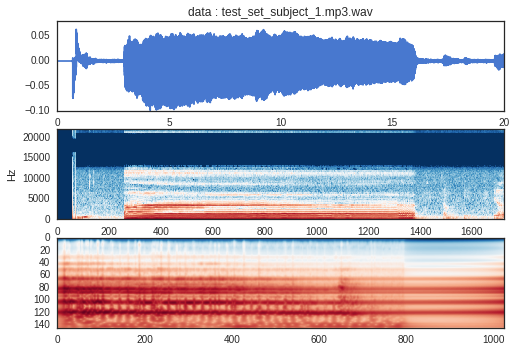

In [11]:
import IPython.display

all_recordings = glob.glob('./data/*.wav')
clip = Clip(all_recordings[random.randint(0, len(all_recordings) - 1)])    

with clip.audio as audio:
    plt.subplot(3, 1, 1)
    plt.title('{0} : {1}'.format(clip.category, clip.filename))
    plt.plot(np.arange(0, len(audio.raw)) / 44100.0, audio.raw)
   
    plt.subplot(3, 1, 2)
    librosa.display.specshow(clip.logamplitude, sr=44100, x_axis='frames', y_axis='linear', cmap='RdBu_r')
    print(clip.logamplitude.shape)
    plt.subplot(3, 1, 3)
    plt.imshow(librosa.logamplitude(clip.scat), aspect='auto', cmap='RdBu_r')
    print(clip.scat.shape)
    
IPython.display.Audio(filename=clip.path, rate=Clip.RATE)

The spectrogram only displays the first 5 seconds of the audio sample that can last up to 2 mins.

# Loading dataset

In [29]:
def load_dataset():
    """Load all dataset recordings into a nested list."""
    train_clips, test_clips = [], []
    path = './data/'
    for clip in sorted(os.listdir(path)):
        clip_path = path+clip
        if clip[-3:] == 'wav':
            print(clip_path, end=',')
            if clip[:4] == 'test':
                test_clips.append(Clip(clip_path))
            else:
                train_clips.append(Clip(clip_path))

    IPython.display.clear_output()
    print('')
    print('All recordings loaded.')            
    
    return train_clips, test_clips

all_clips = load_dataset()


All recordings loaded.


In [31]:
def add_subplot_axes(ax, position):
    box = ax.get_position()
    
    position_display = ax.transAxes.transform(position[0:2])
    position_fig = plt.gcf().transFigure.inverted().transform(position_display)
    x = position_fig[0]
    y = position_fig[1]
    
    return plt.gcf().add_axes([x, y, box.width * position[2], box.height * position[3]], axisbg='w')

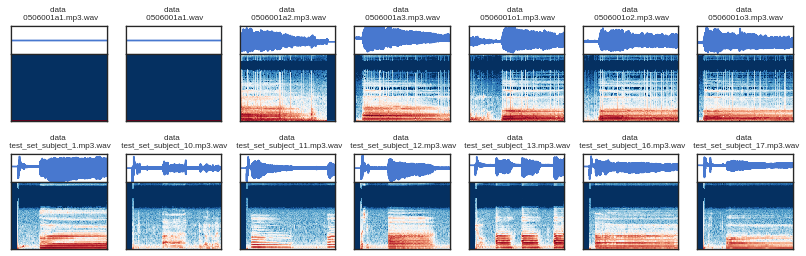

In [32]:
def plot_clip_overview(clip, ax):
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax_waveform = add_subplot_axes(ax, [0.0, 0.7, 1.0, 0.3])
    ax_spectrogram = add_subplot_axes(ax, [0.0, 0.0, 1.0, 0.7])
    
    with clip.audio as audio:
        ax_waveform.plot(np.arange(0, len(audio.raw)) / float(Clip.RATE), audio.raw)
        ax_waveform.get_xaxis().set_visible(False)
        ax_waveform.get_yaxis().set_visible(False)
        ax_waveform.set_title('{0} \n {1}'.format(clip.category, clip.filename), {'fontsize': 8}, y=1.03)
        
        librosa.display.specshow(clip.logamplitude, sr=Clip.RATE, x_axis='time', y_axis='mel', cmap='RdBu_r')
        ax_spectrogram.get_xaxis().set_visible(False)
        ax_spectrogram.get_yaxis().set_visible(False)

categories = 2 #train and test
clips_shown = 7
f, axes = plt.subplots(categories, clips_shown, figsize=(clips_shown * 2, categories * 2), sharex=True, sharey=True)
f.subplots_adjust(hspace = 0.35)

for c in range(0, categories):
    for i in range(0, clips_shown):
        plot_clip_overview(all_clips[c][i], axes[c, i])

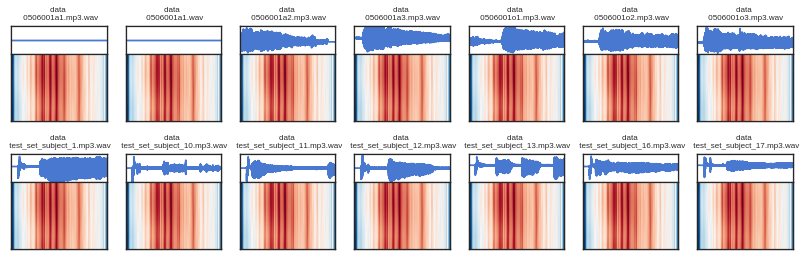

In [35]:
def plot_clip_overview(clip, ax):
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax_waveform = add_subplot_axes(ax, [0.0, 0.7, 1.0, 0.3])
    ax_spectrogram = add_subplot_axes(ax, [0.0, 0.0, 1.0, 0.7])
    
    with clip.audio as audio:
        ax_waveform.plot(np.arange(0, len(audio.raw)) / float(Clip.RATE), audio.raw)
        ax_waveform.get_xaxis().set_visible(False)
        ax_waveform.get_yaxis().set_visible(False)
        ax_waveform.set_title('{0} \n {1}'.format(clip.category, clip.filename), {'fontsize': 8}, y=1.03)
        
        plt.imshow(np.log(clip.scat.T+1e-10), aspect='auto', cmap='RdBu_r')
        ax_spectrogram.get_xaxis().set_visible(False)
        ax_spectrogram.get_yaxis().set_visible(False)

categories = 2 #train and test
clips_shown = 7
f, axes = plt.subplots(categories, clips_shown, figsize=(clips_shown * 2, categories * 2), sharex=True, sharey=True)
f.subplots_adjust(hspace = 0.35)

for c in range(0, categories):
    for i in range(0, clips_shown):
        plot_clip_overview(all_clips[c][i], axes[c, i])

# References
- Andén, Joakim, and Stéphane Mallat. "Deep scattering spectrum." IEEE Transactions on Signal Processing 62.16 (2014): 4114-4128. [paper](https://www.di.ens.fr/~mallat/papiers/AudioScatSpectrum.pdf)
- McFee, Brian, et al. "librosa: Audio and music signal analysis in python." Proceedings of the 14th python in science conference. 2015.

